In [1]:
#pip install plotly

In [2]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()

In [3]:
#dfTrain=pd.read_csv("../datasets/titanic/titanic_train.csv") # 訓練資料

In [4]:
#!dir ..\..\bureau.csv
bureau=pd.read_csv("../../bureau.csv")

In [5]:
#bureau=pd.read_csv("home-credit-default-risk/bureau.csv")

In [6]:
bureau.head(15)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.00,0.00,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.00,171342.00,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.50,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.00,NaN,NaN,0.0,Consumer credit,-21,NaN
5,215354,5714467,Active,currency 1,-273,0,27460.0,NaN,0.0,0,180000.00,71017.38,108982.62,0.0,Credit card,-31,NaN
6,215354,5714468,Active,currency 1,-43,0,79.0,NaN,0.0,0,42103.80,42103.80,0.00,0.0,Consumer credit,-22,NaN
7,162297,5714469,Closed,currency 1,-1896,0,-1684.0,-1710.0,14985.0,0,76878.45,0.00,0.00,0.0,Consumer credit,-1710,NaN
8,162297,5714470,Closed,currency 1,-1146,0,-811.0,-840.0,0.0,0,103007.70,0.00,0.00,0.0,Consumer credit,-840,NaN
9,162297,5714471,Active,currency 1,-1146,0,-484.0,NaN,0.0,0,4500.00,0.00,0.00,0.0,Credit card,-690,NaN


In [7]:
bureau.tail(5)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
1716423,259355,5057750,Active,currency 1,-44,0,-30.0,NaN,0.0,0,11250.00,11250.0,0.0,0.0,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.0,-2493.0,5476.5,0,38130.84,0.0,0.0,0.0,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.0,-970.0,NaN,0,15570.00,NaN,NaN,0.0,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.0,-1513.0,NaN,0,36000.00,0.0,0.0,0.0,Consumer credit,-1508,NaN
1716427,246829,5057778,Closed,currency 1,-463,0,NaN,-387.0,NaN,0,22500.00,0.0,NaN,0.0,Microloan,-387,NaN


In [8]:
bureau.shape

(1716428, 17)

In [9]:
print('bureau共有 {:,} 列。{:,} 欄。總計 {:,} 筆資料。'.format(bureau.shape[0],bureau.shape[1],bureau.size))

bureau共有 1,716,428 列。17 欄。總計 29,179,276 筆資料。


In [10]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    print('missing data')
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])

In [11]:
missing_data(bureau)

missing data


,Total,Percent
AMT_ANNUITY,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,1124488,65.513264
DAYS_ENDDATE_FACT,633653,36.916958
AMT_CREDIT_SUM_LIMIT,591780,34.477415
AMT_CREDIT_SUM_DEBT,257669,15.011932
DAYS_CREDIT_ENDDATE,105553,6.149573
AMT_CREDIT_SUM,13,0.000757
CREDIT_TYPE,0,0.000000
AMT_CREDIT_SUM_OVERDUE,0,0.000000
CNT_CREDIT_PROLONG,0,0.000000


In [12]:
bureau_unique=(bureau.apply(lambda x:x.unique().shape[0],axis=0))
print(bureau_unique)

SK_ID_CURR                 305811
SK_ID_BUREAU              1716428
CREDIT_ACTIVE                   4
CREDIT_CURRENCY                 4
DAYS_CREDIT                  2923
CREDIT_DAY_OVERDUE            942
DAYS_CREDIT_ENDDATE         14097
DAYS_ENDDATE_FACT            2918
AMT_CREDIT_MAX_OVERDUE      68252
CNT_CREDIT_PROLONG             10
AMT_CREDIT_SUM             236709
AMT_CREDIT_SUM_DEBT        226538
AMT_CREDIT_SUM_LIMIT        51727
AMT_CREDIT_SUM_OVERDUE       1616
CREDIT_TYPE                    15
DAYS_CREDIT_UPDATE           2982
AMT_ANNUITY                 40322
dtype: int64


In [13]:
bureau.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
SK_ID_CURR                int64
SK_ID_BUREAU              int64
CREDIT_ACTIVE             object
CREDIT_CURRENCY           object
DAYS_CREDIT               int64
CREDIT_DAY_OVERDUE        int64
DAYS_CREDIT_ENDDATE       float64
DAYS_ENDDATE_FACT         float64
AMT_CREDIT_MAX_OVERDUE    float64
CNT_CREDIT_PROLONG        int64
AMT_CREDIT_SUM            float64
AMT_CREDIT_SUM_DEBT       float64
AMT_CREDIT_SUM_LIMIT      float64
AMT_CREDIT_SUM_OVERDUE    float64
CREDIT_TYPE               object
DAYS_CREDIT_UPDATE        int64
AMT_ANNUITY               float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB


In [14]:
bureau_object = bureau.columns[bureau.dtypes == 'object']
pd.DataFrame(bureau_object,columns=['類別型欄位'])

,類別型欄位
0,CREDIT_ACTIVE
1,CREDIT_CURRENCY
2,CREDIT_TYPE


In [15]:
np.unique(bureau[bureau.columns[bureau.dtypes == 'object']])

array(['Active', 'Another type of loan', 'Bad debt', 'Car loan',
       'Cash loan (non-earmarked)', 'Closed', 'Consumer credit',
       'Credit card', 'Interbank credit', 'Loan for business development',
       'Loan for purchase of shares (margin lending)',
       'Loan for the purchase of equipment',
       'Loan for working capital replenishment', 'Microloan',
       'Mobile operator loan', 'Mortgage', 'Real estate loan', 'Sold',
       'Unknown type of loan', 'currency 1', 'currency 2', 'currency 3',
       'currency 4'], dtype=object)

In [16]:
temp = bureau['CREDIT_TYPE'].value_counts()
print(temp)

Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Interbank credit                                      1
Mobile operator loan                                  1
Name: CREDIT_TYPE, dtype: int64


Closed      1079273
Active       630607
Sold           6527
Bad debt         21
Name: CREDIT_ACTIVE, dtype: int64


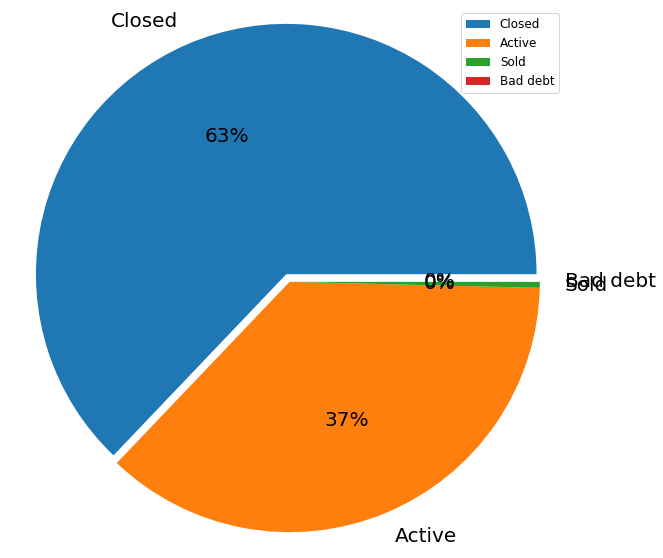

In [17]:
temp = bureau['CREDIT_ACTIVE'].value_counts()
#df = pd.DataFrame({'labels': temp.index,
#                  'values': temp.values
#                  })
#df.iplot(kind='pie',labels='labels',values='values', title='Family Status of Applicant\'s', hole = 0.5)
print(temp)
plt.figure(figsize=(10,10)) 
explode = (0.5,0,0,0)
plt.pie(temp,labels=temp.index,autopct='%.0f%%',textprops = {'fontsize':20, 'color':'k'}, explode=explode, radius = 15)
#plt.pie(temp,labels=temp.index,autopct='%.0f%%',textprops = {'fontsize':20, 'color':'k'})
plt.axis('equal')
plt.legend(loc = "upper right",fontsize="large")

plt.show()

currency 1    1715020
currency 2       1224
currency 3        174
currency 4         10
Name: CREDIT_CURRENCY, dtype: int64


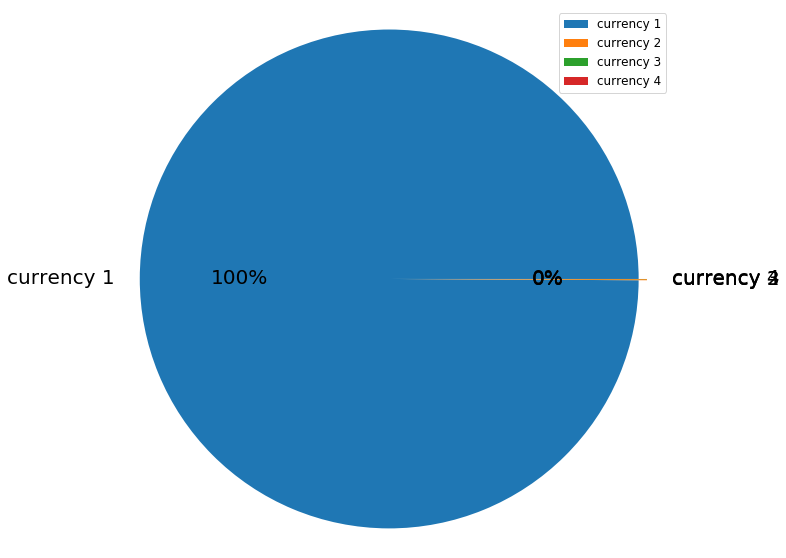

In [18]:
temp = bureau['CREDIT_CURRENCY'].value_counts()
#df = pd.DataFrame({'labels': temp.index,
#                  'values': temp.values
#                  })
#df.iplot(kind='pie',labels='labels',values='values', title='Family Status of Applicant\'s', hole = 0.5)
print(temp)
plt.figure(figsize=(10,10)) 
explode = (0.5,0,0,0)
plt.pie(temp,labels=temp.index,autopct='%.0f%%',textprops = {'fontsize':20, 'color':'k'}, explode=explode, radius = 15)
#plt.pie(temp,labels=temp.index,autopct='%.0f%%',textprops = {'fontsize':20, 'color':'k'})
plt.axis('equal')
plt.legend(loc = "best",fontsize="large")

plt.show()

Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Interbank credit                                      1
Mobile operator loan                                  1
Name: CREDIT_TYPE, dtype: int64


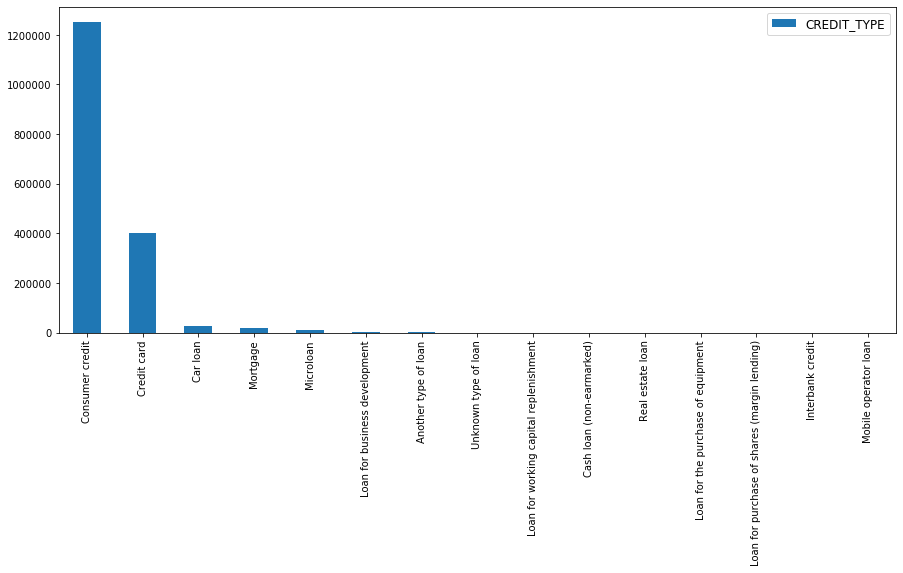

In [19]:
temp = bureau['CREDIT_TYPE'].value_counts()
print(temp)
plt.figure(figsize=(15,6)) 
temp.plot(kind='bar')
plt.legend(loc = "best",fontsize="large")

In [20]:
bureau.describe()

,SK_ID_CURR,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
count,1.716428e+06,1.716428e+06,1.716428e+06,1.716428e+06,1.610875e+06,1.082775e+06,5.919400e+05,1.716428e+06,1.716415e+06,1.458759e+06,1.124648e+06,1.716428e+06,1.716428e+06,4.896370e+05
mean,2.782149e+05,5.924434e+06,-1.142108e+03,8.181666e-01,5.105174e+02,-1.017437e+03,3.825418e+03,6.410406e-03,3.549946e+05,1.370851e+05,6.229515e+03,3.791276e+01,-5.937483e+02,1.571276e+04
std,1.029386e+05,5.322657e+05,7.951649e+02,3.654443e+01,4.994220e+03,7.140106e+02,2.060316e+05,9.622391e-02,1.149811e+06,6.774011e+05,4.503203e+04,5.937650e+03,7.207473e+02,3.258269e+05
min,1.000010e+05,5.000000e+06,-2.922000e+03,0.000000e+00,-4.206000e+04,-4.202300e+04,0.000000e+00,0.000000e+00,0.000000e+00,-4.705600e+06,-5.864061e+05,0.000000e+00,-4.194700e+04,0.000000e+00
25%,1.888668e+05,5.463954e+06,-1.666000e+03,0.000000e+00,-1.138000e+03,-1.489000e+03,0.000000e+00,0.000000e+00,5.130000e+04,0.000000e+00,0.000000e+00,0.000000e+00,-9.080000e+02,0.000000e+00
50%,2.780550e+05,5.926304e+06,-9.870000e+02,0.000000e+00,-3.300000e+02,-8.970000e+02,0.000000e+00,0.000000e+00,1.255185e+05,0.000000e+00,0.000000e+00,0.000000e+00,-3.950000e+02,0.000000e+00
75%,3.674260e+05,6.385681e+06,-4.740000e+02,0.000000e+00,4.740000e+02,-4.250000e+02,0.000000e+00,0.000000e+00,3.150000e+05,4.015350e+04,0.000000e+00,0.000000e+00,-3.300000e+01,1.350000e+04
max,4.562550e+05,6.843457e+06,0.000000e+00,2.792000e+03,3.119900e+04,0.000000e+00,1.159872e+08,9.000000e+00,5.850000e+08,1.701000e+08,4.705600e+06,3.756681e+06,3.720000e+02,1.184534e+08


In [21]:
bureau_int64 = bureau.columns[bureau.dtypes == 'int64']
pd.DataFrame(bureau_int64,columns=['整數型欄位'])

,整數型欄位
0,SK_ID_CURR
1,SK_ID_BUREAU
2,DAYS_CREDIT
3,CREDIT_DAY_OVERDUE
4,CNT_CREDIT_PROLONG
5,DAYS_CREDIT_UPDATE


<function matplotlib.pyplot.show(*args, **kw)>

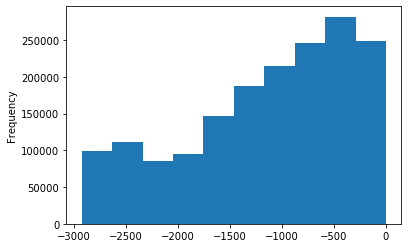

In [22]:
bureau["DAYS_CREDIT"].plot.hist()
plt.show

Text(0.5, 1.0, 'DAYS_CREDIT_UPDATE')

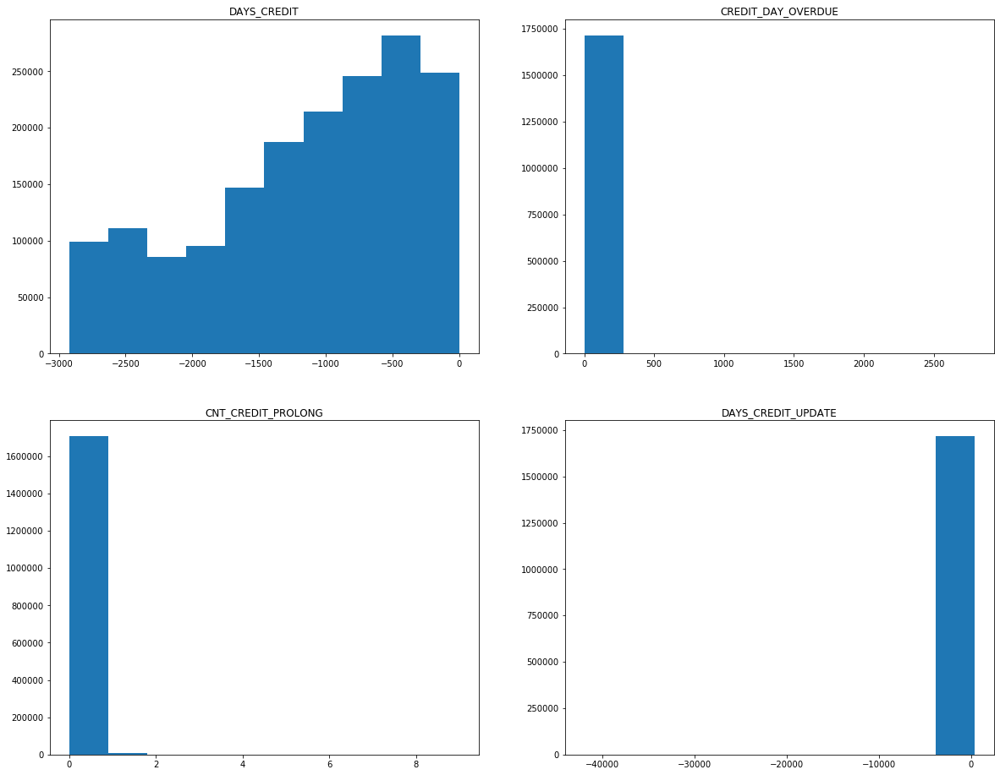

In [23]:
plt.figure(figsize = (20, 16))
#客戶在申請前幾天內申請了信貸局信貸
plt.subplot(2,2,1)
plt.hist(bureau["DAYS_CREDIT"]);
plt.title("DAYS_CREDIT")

#在申請相關貸款時，信貸的逾期天數
plt.subplot(2,2,2)
plt.hist(bureau["CREDIT_DAY_OVERDUE"]);
plt.title("CREDIT_DAY_OVERDUE")

#信貸延長次數
plt.subplot(2,2,3)
plt.hist(bureau["CNT_CREDIT_PROLONG"]);
plt.title("CNT_CREDIT_PROLONG")

#離上次收到貸款訊息幾天了
plt.subplot(2,2,4)
plt.hist(bureau["DAYS_CREDIT_UPDATE"]);
plt.title("DAYS_CREDIT_UPDATE")

In [24]:
temp =bureau["CREDIT_DAY_OVERDUE"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp )

0       1712211
30          311
60          126
13          103
8           103
9            93
7            92
14           91
17           77
11           75
15           74
10           71
12           70
20           68
21           64
18           63
6            59
22           54
19           54
5            51
16           50
28           50
4            46
29           46
26           43
24           42
23           41
25           40
31           38
32           36
150          33
34           33
37           31
35           30
41           30
3            29
38           29
27           28
40           26
120          25
90           25
39           25
44           24
43           23
36           23
33           21
52           19
2            18
46           17
48           16
50           15
69           14
49           14
55           13
53           13
65           12
68           12
73           12
54           12
64           12
51           11
61           11
58      

In [25]:
temp =bureau["CNT_CREDIT_PROLONG"].value_counts()
print(temp)

0    1707314
1       7620
2       1222
3        191
4         54
5         21
9          2
6          2
8          1
7          1
Name: CNT_CREDIT_PROLONG, dtype: int64


In [26]:
temp =bureau["DAYS_CREDIT_UPDATE"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp )

-7        18503
-8        18462
-11       16975
-15       16870
-12       16827
-10       16651
-9        16546
-13       16387
-6        16281
-14       16210
-18       15733
-16       15655
-17       15041
-19       14900
-5        13755
-22       13572
-23       13263
-20       13140
-21       13041
-24       12380
-25       12321
-26       11683
-4        11578
-28       11122
-29       11054
-27       10854
-30        9906
-3         9542
-31        9127
-32        9041
-33        8193
-35        7256
-34        7202
-2         6939
-36        6810
-37        5827
-38        5312
-39        5060
-40        4647
-42        4280
-43        4161
-41        4074
-44        3854
-46        3783
-45        3552
-1         3484
-47        3298
-49        3295
-48        3205
-50        3202
-51        3034
-53        2800
-52        2754
-56        2571
-55        2561
-54        2546
-57        2491
-59        2313
-58        2271
-60        2265
-63        1988
-61        1960
-64     

In [27]:
pd.set_option("display.max_rows",None)
bureau[bureau["SK_ID_CURR"]==215354].sort_values(by=["SK_ID_BUREAU"])

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
225157,215354,5714458,Closed,currency 1,-1872,0,-776.0,-1203.0,NaN,0,494550.0,0.00,0.00,0.0,Consumer credit,-696,NaN
225158,215354,5714459,Closed,currency 1,-1734,0,-638.0,-1336.0,NaN,0,1084032.0,0.00,NaN,0.0,Car loan,-1336,NaN
225159,215354,5714460,Closed,currency 1,-1333,0,-1089.0,-987.0,NaN,0,102150.0,NaN,NaN,0.0,Consumer credit,-984,NaN
225160,215354,5714461,Closed,currency 1,-1011,0,-830.0,-770.0,NaN,0,500463.0,NaN,NaN,0.0,Consumer credit,-767,NaN
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.00,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.00,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN
5,215354,5714467,Active,currency 1,-273,0,27460.0,NaN,0.0,0,180000.0,71017.38,108982.62,0.0,Credit card,-31,NaN


In [28]:
bureau_float64 = bureau.columns[bureau.dtypes == 'float64']
pd.DataFrame(bureau_float64,columns=['浮點數型欄位'])

,浮點數型欄位
0,DAYS_CREDIT_ENDDATE
1,DAYS_ENDDATE_FACT
2,AMT_CREDIT_MAX_OVERDUE
3,AMT_CREDIT_SUM
4,AMT_CREDIT_SUM_DEBT
5,AMT_CREDIT_SUM_LIMIT
6,AMT_CREDIT_SUM_OVERDUE
7,AMT_ANNUITY


DAYS_CREDIT_ENDDATE(申請“Home Credit”時，信貸局信貸的剩餘期限)：資料顯示天數為整數.0，有正負數。異常。


c:\program files\python37\lib\site-packages\numpy\lib\histograms.py:839: RuntimeWarning:

invalid value encountered in greater_equal

c:\program files\python37\lib\site-packages\numpy\lib\histograms.py:840: RuntimeWarning:

invalid value encountered in less_equal



DAYS_ENDDATE_FACT(申請“Home Credit”時，信貸局信貸終止後的天數)：資料顯示天數為整數.0。
AMT_CREDIT_MAX_OVERDUE(逾期的最大金額)：逾期金額為0者最多：470650位，已剔除。
AMT_CREDIT_SUM(貸局信貸的當前信貸金額)：金額為0者最多：66582位，已剔除。
AMT_CREDIT_SUM_DEBT(信貸局信貸的流動負債)：金額為0者最多： 1016434位，已剔除。有正負數-4.500000e+02：543位。異常。
AMT_CREDIT_SUM_LIMIT(當前的信用卡額度)：金額為0者最多：1050142 位，已剔除。
AMT_CREDIT_SUM_OVERDUE(當前逾期金額)：金額為0者最多： 1712270位，已剔除。
AMT_ANNUITY(先前申請的年金，約定每年要償還的金額)：金額為0者最多：256915 位，已剔除。


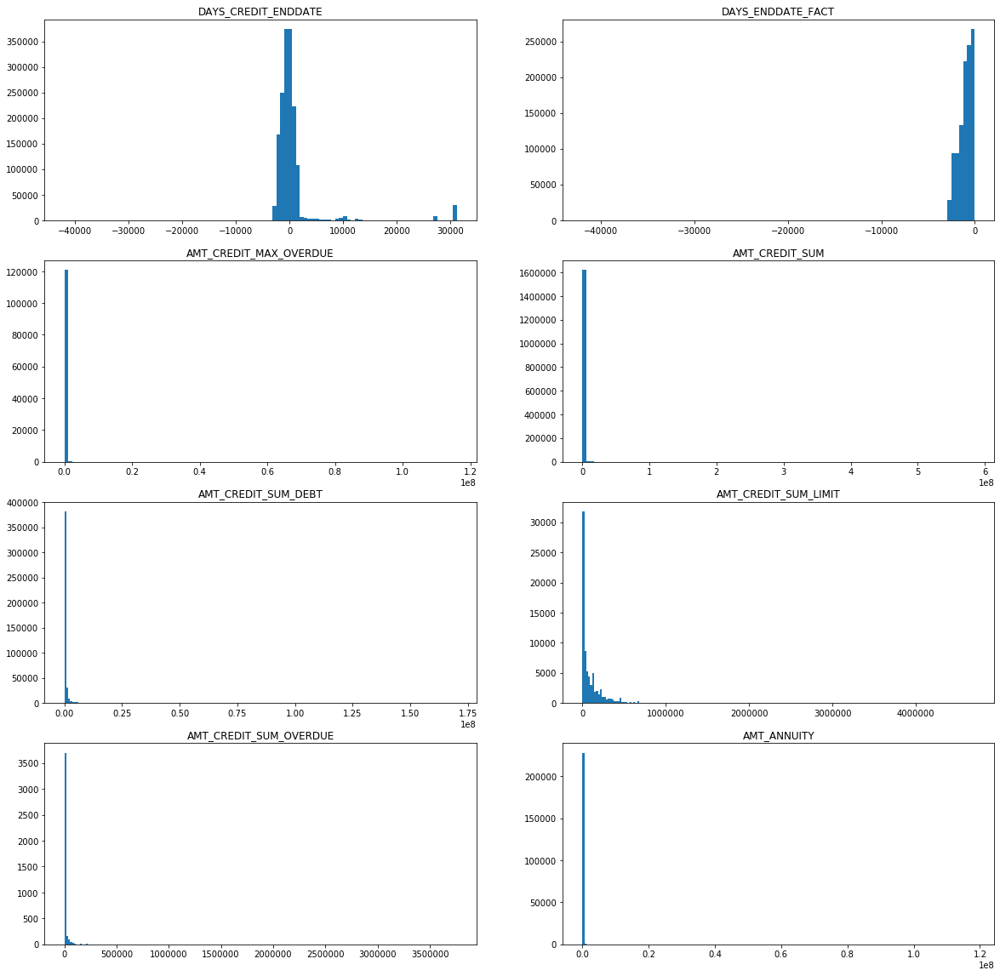

In [29]:
plt.figure(figsize = (20, 20))
#申請“Home Credit”時，信貸局信貸的剩餘期限
plt.subplot(4,2,1)
plt.hist(bureau["DAYS_CREDIT_ENDDATE"], bins=100);
plt.title("DAYS_CREDIT_ENDDATE")
print('DAYS_CREDIT_ENDDATE(申請“Home Credit”時，信貸局信貸的剩餘期限)：資料顯示天數為整數.0，有正負數。異常。')

#申請“Home Credit”時，信貸局信貸終止後的天數
plt.subplot(4,2,2)
plt.hist(bureau["DAYS_ENDDATE_FACT"], bins=100);
plt.title("DAYS_ENDDATE_FACT")
print('DAYS_ENDDATE_FACT(申請“Home Credit”時，信貸局信貸終止後的天數)：資料顯示天數為整數.0。')

#逾期的最大金額
plt.subplot(4,2,3)
plt.hist(bureau["AMT_CREDIT_MAX_OVERDUE"], bins=100,range=(4.500000e+00 ,1.159872e+08));
plt.title("AMT_CREDIT_MAX_OVERDUE")
print('AMT_CREDIT_MAX_OVERDUE(逾期的最大金額)：逾期金額為0者最多：470650位，已剔除。')

#信貸局信貸的當前信貸金額
plt.subplot(4,2,4)
plt.hist(bureau["AMT_CREDIT_SUM"], bins=100,range=(1.350000e+04 , 5.850000e+08));
plt.title("AMT_CREDIT_SUM")
print('AMT_CREDIT_SUM(貸局信貸的當前信貸金額)：金額為0者最多：66582位，已剔除。')


#信貸局信貸的流動負債
plt.subplot(4,2,5)
plt.hist(bureau["AMT_CREDIT_SUM_DEBT"], bins=200,range= (4.500000e+00, 1.701000e+08));
plt.title("AMT_CREDIT_SUM_DEBT")
print('AMT_CREDIT_SUM_DEBT(信貸局信貸的流動負債)：金額為0者最多： 1016434位，已剔除。有正負數-4.500000e+02：543位。異常。')

         
#當前的信用卡額度
plt.subplot(4,2,6)
plt.hist(bureau["AMT_CREDIT_SUM_LIMIT"] , bins=200,range= (4.500,4.705600e+06));
plt.title("AMT_CREDIT_SUM_LIMIT")
print('AMT_CREDIT_SUM_LIMIT(當前的信用卡額度)：金額為0者最多：1050142 位，已剔除。')

#當前逾期金額
plt.subplot(4,2,7)
plt.hist(bureau["AMT_CREDIT_SUM_OVERDUE"], bins=200,range= (4.500,3.756681e+06));
plt.title("AMT_CREDIT_SUM_OVERDUE")
print('AMT_CREDIT_SUM_OVERDUE(當前逾期金額)：金額為0者最多： 1712270位，已剔除。')

#先前申請的年金，約定每年要償還的金額
plt.subplot(4,2,8)
plt.hist(bureau["AMT_ANNUITY"], bins=200,range= (1.350000e+03,1.184534e+08));
plt.title("AMT_ANNUITY")
print('AMT_ANNUITY(先前申請的年金，約定每年要償還的金額)：金額為0者最多：256915 位，已剔除。')


In [30]:
bureau["DAYS_CREDIT_ENDDATE"].describe()

count    1.610875e+06
mean     5.105174e+02
std      4.994220e+03
min     -4.206000e+04
25%     -1.138000e+03
50%     -3.300000e+02
75%      4.740000e+02
max      3.119900e+04
Name: DAYS_CREDIT_ENDDATE, dtype: float64

In [31]:
temp = bureau["DAYS_CREDIT_ENDDATE"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp)

 0.0        883
 3.0        845
-7.0        837
 1.0        830
-14.0       787
-10.0       782
 4.0        777
-2.0        772
-1.0        771
-42.0       768
-16.0       765
-6.0        760
-11.0       750
-20.0       746
-21.0       745
-13.0       744
-8.0        742
-22.0       740
-29.0       740
-12.0       740
-119.0      738
 6.0        735
-15.0       734
 7.0        734
-36.0       727
 5.0        726
-43.0       723
-63.0       716
-35.0       710
-26.0       708
-18.0       707
-28.0       707
-25.0       706
-31.0       705
-3.0        705
-4.0        704
 2.0        704
-34.0       703
-64.0       701
-53.0       700
-112.0      699
-168.0      699
-17.0       696
-5.0        695
-23.0       693
-329.0      692
-77.0       689
-47.0       688
-40.0       686
-24.0       686
-154.0      682
-84.0       682
-49.0       680
-48.0       679
-33.0       678
-78.0       677
-91.0       677
-238.0      676
-9.0        675
-127.0      674
-27.0       674
 10.0       674
-57.0   

In [32]:
bureau["DAYS_ENDDATE_FACT"].describe()

count    1.082775e+06
mean    -1.017437e+03
std      7.140106e+02
min     -4.202300e+04
25%     -1.489000e+03
50%     -8.970000e+02
75%     -4.250000e+02
max      0.000000e+00
Name: DAYS_ENDDATE_FACT, dtype: float64

In [33]:
temp=bureau["DAYS_ENDDATE_FACT"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp)

-329.0      811
-273.0      794
-301.0      791
-91.0       785
-84.0       783
-154.0      783
-182.0      782
-210.0      778
-238.0      778
-280.0      773
-350.0      773
-147.0      772
-294.0      770
-119.0      769
-925.0      768
-924.0      767
-910.0      765
-917.0      765
-336.0      763
-315.0      760
-434.0      759
-469.0      757
-203.0      755
-189.0      755
-259.0      753
-357.0      752
-253.0      750
-351.0      748
-364.0      746
-309.0      745
-322.0      742
-308.0      742
-343.0      741
-196.0      740
-245.0      739
-231.0      739
-302.0      738
-274.0      734
-175.0      734
-476.0      733
-966.0      733
-497.0      731
-217.0      730
-127.0      730
-56.0       729
-448.0      727
-399.0      727
-427.0      726
-204.0      726
-406.0      725
-420.0      724
-371.0      724
-260.0      723
-931.0      722
-337.0      722
-287.0      722
-161.0      721
-484.0      719
-456.0      718
-323.0      718
-252.0      718
-413.0      717
-77.0   

In [34]:
bureau["AMT_CREDIT_MAX_OVERDUE"].describe()

count    5.919400e+05
mean     3.825418e+03
std      2.060316e+05
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      1.159872e+08
Name: AMT_CREDIT_MAX_OVERDUE, dtype: float64

In [35]:
temp=bureau["AMT_CREDIT_MAX_OVERDUE"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp)

0.000000e+00    470650
1.440000e+03       688
2.250000e+02       405
4.500000e+01       377
4.500000e+00       315
9.000000e+01       222
4.500000e+03       220
2.700000e+03       192
9.000000e+03       192
5.400000e+03       189
3.600000e+03       184
6.750000e+03       181
1.350000e+04       169
9.000000e+00       164
7.200000e+03       159
1.800000e+01       157
1.350000e+02       152
1.080000e+04       147
1.800000e+02       145
2.250000e+03       139
4.500000e+02       129
1.350000e+03       128
1.800000e+03       127
1.350000e+01       126
2.250000e+01       126
1.125000e+04       125
2.700000e+01       114
4.050000e+03       102
3.375000e+03       101
4.950000e+03        99
5.625000e+03        98
2.700000e+02        98
3.600000e+01        98
1.800000e+04        94
2.250000e+04        94
4.140000e+03        93
5.220000e+03        92
3.150000e+03        92
3.150000e+01        92
1.440000e+04        89
4.275000e+03        89
5.850000e+03        88
4.365000e+03        88
4.050000e+0

In [36]:
#處理Jupyter Notebook報错：IOPub data rate exceeded
# cmd key => jupyter notebook --generate-config
#https://blog.csdn.net/LaoChengZier/article/details/80705298  詳細說明

In [37]:
bureau["AMT_CREDIT_SUM"].describe()

count    1.716415e+06
mean     3.549946e+05
std      1.149811e+06
min      0.000000e+00
25%      5.130000e+04
50%      1.255185e+05
75%      3.150000e+05
max      5.850000e+08
Name: AMT_CREDIT_SUM, dtype: float64

In [38]:
temp=bureau["AMT_CREDIT_SUM"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp)

0.000000e+00    66582
2.250000e+05    57608
1.350000e+05    50195
4.500000e+05    37156
9.000000e+04    36940
1.800000e+05    28840
4.500000e+04    26570
6.750000e+04    25444
2.700000e+05    22467
6.750000e+05    20581
1.125000e+05    17521
9.000000e+05    16030
1.350000e+04    12569
1.350000e+06    12551
3.600000e+05    12283
3.150000e+05    12159
2.250000e+04    12112
1.575000e+05    10660
2.025000e+05     9166
4.500000e+03     9128
5.400000e+05     8016
3.375000e+05     7954
1.125000e+06     6909
4.050000e+05     5578
2.475000e+05     5102
5.850000e+05     4541
2.250000e+06     4503
1.800000e+04     4449
3.240000e+05     4262
4.950000e+05     4074
9.000000e+03     3939
6.300000e+05     3870
2.700000e+04     3852
2.925000e+05     3800
1.800000e+06     3572
5.400000e+04     3486
1.035000e+05     3078
8.100000e+04     3044
1.575000e+06     2941
3.600000e+04     2769
3.150000e+04     2764
8.100000e+05     2671
7.200000e+04     2625
7.200000e+05     2551
1.440000e+05     2487
1.080000e+

In [39]:
bureau["AMT_CREDIT_SUM_DEBT"].describe()

count    1.458759e+06
mean     1.370851e+05
std      6.774011e+05
min     -4.705600e+06
25%      0.000000e+00
50%      0.000000e+00
75%      4.015350e+04
max      1.701000e+08
Name: AMT_CREDIT_SUM_DEBT, dtype: float64

In [40]:
temp=bureau["AMT_CREDIT_SUM_DEBT"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp)

 0.000000e+00    1016434
 4.500000e+00        653
-4.500000e+02        543
 1.350000e+05        344
 9.000000e+04        320
 4.500000e+04        316
 2.250000e+04        307
 6.750000e+04        238
 2.250000e+05        237
 1.350000e+04        205
 4.500000e+05        177
 1.125000e+05        156
 1.800000e+04        143
 1.575000e+05        139
 2.700000e+04        132
 5.400000e+04        125
 9.000000e+03        121
 2.700000e+05        107
 2.295000e+04        101
 9.000000e+05         98
 6.750000e+05         97
 1.800000e+05         97
 9.000000e+00         94
 2.250000e+02         88
-4.500000e+01         84
 3.150000e+04         84
 3.600000e+04         81
 4.500000e+02         81
 1.350000e+06         81
 4.950000e+04         81
 6.750000e+01         79
 2.520000e+04         78
 1.377000e+04         74
 2.385000e+04         69
 3.150000e+05         68
 1.350000e+01         68
 5.850000e+04         68
 2.340000e+04         67
 4.500000e+03         65
 4.500450e+04         65


In [41]:
bureau["AMT_CREDIT_SUM_LIMIT"].describe()

count    1.124648e+06
mean     6.229515e+03
std      4.503203e+04
min     -5.864061e+05
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      4.705600e+06
Name: AMT_CREDIT_SUM_LIMIT, dtype: float64

In [42]:
temp=bureau["AMT_CREDIT_SUM_LIMIT"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp )

 0.000          1050142
 135000.000        2178
 4500.000          1474
 45000.000         1335
 90000.000          974
 13500.000          833
 22500.000          766
 225000.000         757
 67500.000          678
 450000.000         558
 180000.000         495
 270000.000         305
 112500.000         279
 337500.000         244
 4.500              231
 135450.000         183
 675000.000         166
 202500.000         159
 315000.000         152
 157500.000         147
 27000.000          143
 360000.000         133
 9000.000           112
 225450.000         107
 31500.000          106
 18000.000          102
 405000.000          99
 36000.000           98
 81000.000           98
 0.450               90
 108000.000          89
 99000.000           87
 162000.000          85
 54000.000           85
 63000.000           83
 76500.000           83
 126000.000          81
 117000.000          79
 78750.000           76
 49500.000           76
 247500.000          75
 121500.000     

In [43]:
bureau["AMT_CREDIT_SUM_OVERDUE"].describe()

count    1.716428e+06
mean     3.791276e+01
std      5.937650e+03
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      3.756681e+06
Name: AMT_CREDIT_SUM_OVERDUE, dtype: float64

In [44]:
temp=bureau["AMT_CREDIT_SUM_OVERDUE"].value_counts()
#print(temp)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(temp )

0.000          1712270
4.500              301
9.000              107
13.500              81
18.000              72
22.500              60
45.000              56
27.000              52
36.000              50
31.500              48
54.000              41
40.500              40
58.500              33
675.000             32
49.500              31
72.000              29
63.000              28
148.500             28
90.000              28
67.500              28
180.000             27
76.500              25
94.500              23
99.000              21
130.500             20
135.000             20
315.000             19
175.500             19
81.000              19
112.500             19
450.000             18
85.500              18
139.500             17
270.000             17
108.000             17
144.000             17
117.000             17
504.000             17
126.000             17
121.500             16
540.000             16
360.000             15
220.500             15
265.500    

In [45]:
bureau["AMT_ANNUITY"].describe()

count    4.896370e+05
mean     1.571276e+04
std      3.258269e+05
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      1.350000e+04
max      1.184534e+08
Name: AMT_ANNUITY, dtype: float64

In [46]:
temp=bureau["AMT_ANNUITY"].value_counts()
print('前15筆')
print(temp.head(15))

print()
print('後15筆')
print(temp.tail(15))

#跑全部會很久
#print(temp)
#with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
#    print(temp)

前15筆
0.0        256915
4500.0       5182
13500.0      3147
22500.0      2502
9000.0       1725
18000.0      1605
45000.0      1593
27000.0      1252
2700.0       1208
6750.0       1164
11250.0       966
450.0         749
2250.0        664
33750.0       622
20250.0       546
Name: AMT_ANNUITY, dtype: int64

後15筆
466038.000    1
12267.990     1
29135.250     1
67131.000     1
3490.380      1
4872.015      1
7590.690      1
7476.930      1
8322.705      1
12389.715     1
466407.000    1
12867.525     1
4887.360      1
4708.980      1
3176.190      1
Name: AMT_ANNUITY, dtype: int64


# 下面先略過

In [47]:
bureau.apply(lambda x:x.unique().shape[0],axis=0)

SK_ID_CURR                 305811
SK_ID_BUREAU              1716428
CREDIT_ACTIVE                   4
CREDIT_CURRENCY                 4
DAYS_CREDIT                  2923
CREDIT_DAY_OVERDUE            942
DAYS_CREDIT_ENDDATE         14097
DAYS_ENDDATE_FACT            2918
AMT_CREDIT_MAX_OVERDUE      68252
CNT_CREDIT_PROLONG             10
AMT_CREDIT_SUM             236709
AMT_CREDIT_SUM_DEBT        226538
AMT_CREDIT_SUM_LIMIT        51727
AMT_CREDIT_SUM_OVERDUE       1616
CREDIT_TYPE                    15
DAYS_CREDIT_UPDATE           2982
AMT_ANNUITY                 40322
dtype: int64

In [48]:
#bureau.columns[bureau.dtypes == 'object']
for i in bureau.columns[bureau.dtypes == 'object']:
    print(i)

CREDIT_ACTIVE
CREDIT_CURRENCY
CREDIT_TYPE


In [49]:
np.unique(bureau['CREDIT_ACTIVE'])

array(['Active', 'Bad debt', 'Closed', 'Sold'], dtype=object)

In [50]:
np.unique(bureau['CREDIT_CURRENCY'])

array(['currency 1', 'currency 2', 'currency 3', 'currency 4'],
      dtype=object)

In [51]:
np.unique(bureau['CREDIT_TYPE'])

array(['Another type of loan', 'Car loan', 'Cash loan (non-earmarked)',
       'Consumer credit', 'Credit card', 'Interbank credit',
       'Loan for business development',
       'Loan for purchase of shares (margin lending)',
       'Loan for the purchase of equipment',
       'Loan for working capital replenishment', 'Microloan',
       'Mobile operator loan', 'Mortgage', 'Real estate loan',
       'Unknown type of loan'], dtype=object)

In [52]:
b= pd.unique(bureau['CREDIT_ACTIVE'])
c= pd.DataFrame(b,columns=['CREDIT_ACTIVE'])
#print('CREDIT_ACTIVE', b)
c

,CREDIT_ACTIVE
0,Closed
1,Active
2,Sold
3,Bad debt


In [53]:
#pd.unique?

In [54]:
d = np.unique(bureau[bureau.columns[bureau.dtypes == 'object']])
d

array(['Active', 'Another type of loan', 'Bad debt', 'Car loan',
       'Cash loan (non-earmarked)', 'Closed', 'Consumer credit',
       'Credit card', 'Interbank credit', 'Loan for business development',
       'Loan for purchase of shares (margin lending)',
       'Loan for the purchase of equipment',
       'Loan for working capital replenishment', 'Microloan',
       'Mobile operator loan', 'Mortgage', 'Real estate loan', 'Sold',
       'Unknown type of loan', 'currency 1', 'currency 2', 'currency 3',
       'currency 4'], dtype=object)

In [55]:
e= pd.DataFrame(columns=[bureau.columns[bureau.dtypes == 'object']])
e

,CREDIT_ACTIVE,CREDIT_CURRENCY,CREDIT_TYPE


In [56]:
#pd.concat

In [57]:
bureau.isnull().any()

SK_ID_CURR                False
SK_ID_BUREAU              False
CREDIT_ACTIVE             False
CREDIT_CURRENCY           False
DAYS_CREDIT               False
CREDIT_DAY_OVERDUE        False
DAYS_CREDIT_ENDDATE        True
DAYS_ENDDATE_FACT          True
AMT_CREDIT_MAX_OVERDUE     True
CNT_CREDIT_PROLONG        False
AMT_CREDIT_SUM             True
AMT_CREDIT_SUM_DEBT        True
AMT_CREDIT_SUM_LIMIT       True
AMT_CREDIT_SUM_OVERDUE    False
CREDIT_TYPE               False
DAYS_CREDIT_UPDATE        False
AMT_ANNUITY                True
dtype: bool

In [58]:
bureau.isnull().sum()

SK_ID_CURR                      0
SK_ID_BUREAU                    0
CREDIT_ACTIVE                   0
CREDIT_CURRENCY                 0
DAYS_CREDIT                     0
CREDIT_DAY_OVERDUE              0
DAYS_CREDIT_ENDDATE        105553
DAYS_ENDDATE_FACT          633653
AMT_CREDIT_MAX_OVERDUE    1124488
CNT_CREDIT_PROLONG              0
AMT_CREDIT_SUM                 13
AMT_CREDIT_SUM_DEBT        257669
AMT_CREDIT_SUM_LIMIT       591780
AMT_CREDIT_SUM_OVERDUE          0
CREDIT_TYPE                     0
DAYS_CREDIT_UPDATE              0
AMT_ANNUITY               1226791
dtype: int64

In [59]:
pd.DataFrame((bureau.isnull().sum()*100)/(bureau.index.size-1),columns=['isnull%'])

,isnull%
SK_ID_CURR,0.000000
SK_ID_BUREAU,0.000000
CREDIT_ACTIVE,0.000000
CREDIT_CURRENCY,0.000000
DAYS_CREDIT,0.000000
CREDIT_DAY_OVERDUE,0.000000
DAYS_CREDIT_ENDDATE,6.149577
DAYS_ENDDATE_FACT,36.916979
AMT_CREDIT_MAX_OVERDUE,65.513302
CNT_CREDIT_PROLONG,0.000000


In [60]:
bureau.index.size-1

1716427

In [61]:
bureau.corr()

,SK_ID_CURR,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
SK_ID_CURR,1.000000,0.000135,0.000266,0.000283,0.000456,-0.000648,0.001329,-0.000388,0.001179,-0.000790,-0.000304,-0.000014,0.000510,-0.002727
SK_ID_BUREAU,0.000135,1.000000,0.013015,-0.002628,0.009107,0.017890,0.002290,-0.000740,0.007962,0.005732,-0.003986,-0.000499,0.019398,0.001799
DAYS_CREDIT,0.000266,0.013015,1.000000,-0.027266,0.225682,0.875359,-0.014724,-0.030460,0.050883,0.135397,0.025140,-0.000383,0.688771,0.005676
CREDIT_DAY_OVERDUE,0.000283,-0.002628,-0.027266,1.000000,-0.007352,-0.008637,0.001249,0.002756,-0.003292,-0.002355,-0.000345,0.090951,-0.018461,-0.000339
DAYS_CREDIT_ENDDATE,0.000456,0.009107,0.225682,-0.007352,1.000000,0.248825,0.000577,0.113683,0.055424,0.081298,0.095421,0.001077,0.248525,0.000475
DAYS_ENDDATE_FACT,-0.000648,0.017890,0.875359,-0.008637,0.248825,1.000000,0.000999,0.012017,0.059096,0.019609,0.019476,-0.000332,0.751294,0.006274
AMT_CREDIT_MAX_OVERDUE,0.001329,0.002290,-0.014724,0.001249,0.000577,0.000999,1.000000,0.001523,0.081663,0.014007,-0.000112,0.015036,-0.000749,0.001578
CNT_CREDIT_PROLONG,-0.000388,-0.000740,-0.030460,0.002756,0.113683,0.012017,0.001523,1.000000,-0.008345,-0.001366,0.073805,0.000002,0.017864,-0.000465
AMT_CREDIT_SUM,0.001179,0.007962,0.050883,-0.003292,0.055424,0.059096,0.081663,-0.008345,1.000000,0.683419,0.003756,0.006342,0.104629,0.049146
AMT_CREDIT_SUM_DEBT,-0.000790,0.005732,0.135397,-0.002355,0.081298,0.019609,0.014007,-0.001366,0.683419,1.000000,-0.018215,0.008046,0.141235,0.025507


In [62]:
#plt.figure(figsize=(20,20),dpi=200)
#sns.heatmap(np.abs(bureau.corr()),cmap="Blues",
#           vmin=0,
#          vmax=1,
#          square=True,
#           annot=True)
#plt.show()

In [63]:
#plt.figure(figsize=(20,20),dpi=200)

##sns.pairplot(data=bureau, vars=["SK_ID_BUREAU", "MONTHS_BALANCE", "STATUS"])
#sns.pairplot(data=bureau, vars=bureau.columns[0:5])
#plt.show()

In [64]:
#plt.figure(figsize=(20,20),dpi=200)

##sns.pairplot(data=bureau, vars=["SK_ID_BUREAU", "MONTHS_BALANCE", "STATUS"])
#sns.pairplot(data=bureau, vars=bureau.columns[0:10])
#plt.show()

In [65]:
#plt.figure(figsize=(20,20),dpi=200)

##sns.pairplot(data=bureau, vars=["SK_ID_BUREAU", "MONTHS_BALANCE", "STATUS"])
#sns.pairplot(data=bureau, vars=bureau.columns[10:18])
#plt.show()

In [66]:
#plt.figure(figsize=(20,12),dpi=200)

#sns.pairplot(data=bureau, vars=["SK_ID_CURR", "SK_ID_BUREAU", "DAYS_CREDIT"])
#sns.pairplot(data=bureau, vars=bureau.columns)
#plt.show()